<a href="https://colab.research.google.com/github/dfklsna/sangwoo-Kim/blob/main/Diffusion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#확산 모델
-----
출처: https://github.com/rickiepark/Generative_Deep_Learning_2nd_Edition/blob/main/notebooks/08_diffusion/01_ddm/ddm.ipynb

In [1]:
!pip install --upgrade tensorflow

In [2]:
import sys
sys.path.append('./notebooks')  # 'notebooks' 경로를 Python 모듈 경로에 추가

# Google Colab 환경인지 확인합니다.
if 'google.colab' in sys.modules:
    # 깃허브에서 필요한 유틸리티 파일(utils.py)을 다운로드합니다.
    !wget https://raw.githubusercontent.com/rickiepark/Generative_Deep_Learning_2nd_Edition/main/notebooks/utils.py

    # notebooks 디렉토리를 생성하고 utils.py 파일을 이동합니다.
    !mkdir -p notebooks
    !mv utils.py notebooks

    # 출력 결과와 모델 데이터를 저장할 디렉토리를 생성합니다.
    !mkdir output
    !mkdir models
else:
    # Colab이 아닌 환경에서는 특정 경로를 Python 경로에 추가합니다.
    sys.path.append('../../../')


--2024-12-22 16:46:03--  https://raw.githubusercontent.com/rickiepark/Generative_Deep_Learning_2nd_Edition/main/notebooks/utils.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.108.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 771 [text/plain]
Saving to: ‘utils.py’

utils.py            100%[===================>]     771  --.-KB/s    in 0s      

2024-12-22 16:46:03 (40.0 MB/s) - ‘utils.py’ saved [771/771]

mkdir: cannot create directory ‘output’: File exists
mkdir: cannot create directory ‘models’: File exists


In [3]:
# 데이터 분석 및 시각화 라이브러리 임포트
import numpy as np  # 다차원 배열 및 수치 연산을 위한 라이브러리
import matplotlib.pyplot as plt  # 데이터 시각화를 위한 라이브러리
import seaborn as sns  # 고급 데이터 시각화를 위한 라이브러리

# Seaborn의 색상 팔레트를 설정
sns.set_palette('colorblind')  # 색맹 친화적인 색상 팔레트를 사용하여 시각화를 향상

# 수학 연산 라이브러리 임포트
import math  # 수학 연산 함수(예: 삼각 함수, 로그)를 사용하기 위한 모듈

# 딥러닝 프레임워크 TensorFlow와 Keras 관련 모듈 임포트
import tensorflow as tf
from tensorflow.keras import (
    layers,  # 신경망의 구성 요소인 층(layer)을 정의하는 모듈
    models,  # 전체 모델을 생성하고 관리하는 모듈
    optimizers,  # 모델 학습을 위한 최적화 알고리즘 (예: Adam, SGD)
    utils,  # 모델과 관련된 다양한 유틸리티 함수
    callbacks,  # 학습 중 특정 이벤트에서 실행될 콜백 함수
    metrics,  # 모델 평가를 위한 메트릭 (예: 정확도, 손실 등)
    losses,  # 손실 함수 (예: Mean Squared Error, Binary Crossentropy)
    activations,  # 활성화 함수 (예: ReLU, sigmoid)
)

# 외부 유틸리티 함수 가져오기
from notebooks.utils import display, sample_batch

# display: 이미지를 화면에 출력하거나 파일로 저장하는 함수
# sample_batch: 데이터셋에서 샘플 배치를 가져오는 함수


## 1. 파라미터
-----

In [4]:
# 이미지 크기 설정
IMAGE_SIZE = 64  # 훈련 및 생성에 사용할 이미지의 크기 (64x64 픽셀)

# 배치 크기 설정
BATCH_SIZE = 64  # 한 번에 처리할 이미지 데이터 개수

# 데이터셋 반복 횟수
DATASET_REPETITIONS = 5  # 데이터셋을 반복하여 모델 훈련을 강화

# 모델 로드 설정
LOAD_MODEL = False  # 기존 모델 가중치를 로드할지 여부 (True: 로드, False: 새로 학습)

# 노이즈 임베딩 크기
NOISE_EMBEDDING_SIZE = 32  # 노이즈 임베딩 벡터의 크기 (모델 입력에 사용)

# 디퓨전 스텝 수
PLOT_DIFFUSION_STEPS = 20  # 생성된 이미지를 시각화할 때 사용할 디퓨전 스텝 수

# 최적화 하이퍼파라미터
EMA = 0.999  # 지수 이동 평균(Exponential Moving Average) 계수
LEARNING_RATE = 1e-3  # 학습률 (모델의 가중치를 업데이트하는 속도)
WEIGHT_DECAY = 1e-4  # 가중치 감쇠(L2 정규화) 계수 (과적합 방지)

# 훈련 반복 횟수
EPOCHS = 50  # 전체 데이터셋을 학습할 총 반복 횟수


## 2. 데이터 준비
-----

In [5]:
# Google Colab 환경에서 CelebA 데이터셋 다운로드 및 준비
if 'google.colab' in sys.modules:
    # Kaggle API 인증을 위해 필요한 kaggle.json 파일을 업로드합니다.
    # 사용자 안내: Kaggle 계정에서 API Token(kaggle.json)을 생성하고 Colab에 업로드하세요.
    # Kaggle: Settings -> API -> Create New Token
    from google.colab import files
    files.upload()  # 사용자가 kaggle.json 파일을 업로드하도록 요청합니다.

    # Kaggle API 인증 설정
    !mkdir ~/.kaggle  # Kaggle 인증 파일을 저장할 디렉토리 생성
    !cp kaggle.json ~/.kaggle/  # 업로드된 kaggle.json 파일을 지정된 디렉토리로 이동
    !chmod 600 ~/.kaggle/kaggle.json  # 인증 파일에 안전한 권한 설정

    # Kaggle 데이터셋 다운로드 (현재는 PyTorch 챌린지 데이터셋 사용)
    # 원하는 데이터셋의 ID를 수정하여 다운로드할 수 있습니다.
    !kaggle datasets download -d nunenuh/pytorch-challange-flower-dataset

    # 다운로드한 데이터셋(zip 파일)을 압축 해제합니다.
    # '-q' 옵션은 압축 해제 과정에서 출력 메시지를 생략합니다.
    !unzip -q pytorch-challange-flower-dataset.zip

    # 결과를 저장할 output 디렉토리를 생성합니다.
    # 모델이 생성한 이미지를 저장하는 데 사용됩니다.
    !mkdir output


Saving kaggle.json to kaggle (5).json
mkdir: cannot create directory ‘/root/.kaggle’: File exists
Dataset URL: https://www.kaggle.com/datasets/nunenuh/pytorch-challange-flower-dataset
License(s): CC0-1.0
pytorch-challange-flower-dataset.zip: Skipping, found more recently modified local copy (use --force to force download)
replace README.md? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
mkdir: cannot create directory ‘output’: File exists


In [6]:
# 데이터 로드 및 이미지 데이터셋 생성
train_data = utils.image_dataset_from_directory(
    "./dataset/",  # 이미지 데이터셋이 저장된 디렉토리 경로
    labels=None,  # 데이터셋에 라벨을 사용하지 않음 (비지도 학습의 경우)
    image_size=(IMAGE_SIZE, IMAGE_SIZE),  # 이미지 크기를 64x64로 리사이즈
    batch_size=None,  # 배치 크기를 지정하지 않음 (후에 batch 처리 가능)
    shuffle=True,  # 데이터를 무작위로 섞어 학습에 다양성을 추가
    seed=42,  # 셔플 및 무작위 동작의 일관성을 위한 시드값
    interpolation="bilinear",  # 리사이즈 시 사용되는 보간(interpolation) 방식
)


Found 8189 files.


In [7]:
# 데이터 전처리 함수 정의
def preprocess(img):
    # 이미지를 float32로 변환하고 픽셀 값을 0~1 범위로 정규화
    img = tf.cast(img, "float32") / 255.0
    return img

# 데이터셋에 전처리 적용
train = train_data.map(lambda x: preprocess(x))  # 각 이미지를 preprocess 함수로 변환

# 데이터셋 반복 설정
train = train.repeat(DATASET_REPETITIONS)  # 데이터셋을 지정된 횟수만큼 반복

# 배치 처리 및 나머지 데이터 제거
train = train.batch(BATCH_SIZE, drop_remainder=True)  # 배치 크기 설정 및 불완전 배치 제거


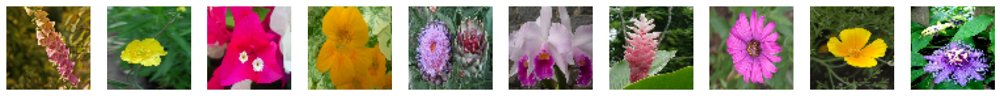

In [8]:
# 훈련 세트에서 샘플 배치 데이터를 가져옵니다.
train_sample = sample_batch(train)  # 훈련 데이터에서 샘플 이미지를 가져옴

# 샘플 이미지를 출력합니다.
display(train_sample)  # 이미지 데이터를 화면에 표시하거나 저장


## 2.1 확산 스케줄
-----

In [9]:
# 선형 디퓨전 스케줄을 계산하는 함수 정의
def linear_diffusion_schedule(diffusion_times):
    # 최소 및 최대 노이즈 증가율 설정
    min_rate = 0.0001  # 최소 노이즈 증가율
    max_rate = 0.02    # 최대 노이즈 증가율

    # 베타 값(노이즈 증가율)을 선형적으로 계산
    betas = min_rate + diffusion_times * (max_rate - min_rate)

    # 알파 값(신호 감소율)을 계산
    alphas = 1 - betas

    # 누적된 알파 값(알파 바)을 계산
    alpha_bars = tf.math.cumprod(alphas)  # 각 스텝에서 알파의 누적 곱

    # 신호 비율과 노이즈 비율 계산
    signal_rates = tf.sqrt(alpha_bars)       # 신호 비율
    noise_rates = tf.sqrt(1 - alpha_bars)    # 노이즈 비율

    # 노이즈 비율과 신호 비율 반환
    return noise_rates, signal_rates


In [10]:
# 코사인 디퓨전 스케줄을 계산하는 함수 정의
def cosine_diffusion_schedule(diffusion_times):
    # 신호 비율 계산
    # 디퓨전 시간에 따라 코사인 값을 사용하여 신호 비율을 정의
    signal_rates = tf.cos(diffusion_times * math.pi / 2)

    # 노이즈 비율 계산
    # 디퓨전 시간에 따라 사인 값을 사용하여 노이즈 비율을 정의
    noise_rates = tf.sin(diffusion_times * math.pi / 2)

    # 노이즈 비율과 신호 비율 반환
    return noise_rates, signal_rates


In [11]:
# 오프셋 코사인 디퓨전 스케줄을 계산하는 함수 정의
def offset_cosine_diffusion_schedule(diffusion_times):
    # 최소 및 최대 신호 비율 설정
    min_signal_rate = 0.02  # 최소 신호 비율
    max_signal_rate = 0.95  # 최대 신호 비율

    # 시작 및 종료 각도 계산 (신호 비율에 따른 역코사인 값)
    start_angle = tf.acos(max_signal_rate)  # 시작 각도
    end_angle = tf.acos(min_signal_rate)    # 종료 각도

    # 디퓨전 각도를 계산
    # 시작 각도와 종료 각도 사이에서 diffusion_times에 따라 선형적으로 변화
    diffusion_angles = start_angle + diffusion_times * (end_angle - start_angle)

    # 신호 비율 계산 (코사인 값)
    signal_rates = tf.cos(diffusion_angles)

    # 노이즈 비율 계산 (사인 값)
    noise_rates = tf.sin(diffusion_angles)

    # 노이즈 비율과 신호 비율 반환
    return noise_rates, signal_rates


In [12]:
# 디퓨전 스텝 설정
T = 1000  # 총 디퓨전 스텝 수

# 디퓨전 시간 정의
# 0에서 1까지의 구간을 T 스텝으로 나눈 값
diffusion_times = tf.convert_to_tensor([x / T for x in range(T)])

# 선형 디퓨전 스케줄 계산
linear_noise_rates, linear_signal_rates = linear_diffusion_schedule(diffusion_times)

# 코사인 디퓨전 스케줄 계산
cosine_noise_rates, cosine_signal_rates = cosine_diffusion_schedule(diffusion_times)

# 오프셋 코사인 디퓨전 스케줄 계산
(
    offset_cosine_noise_rates,  # 오프셋 코사인 기반 노이즈 비율
    offset_cosine_signal_rates, # 오프셋 코사인 기반 신호 비율
) = offset_cosine_diffusion_schedule(diffusion_times)


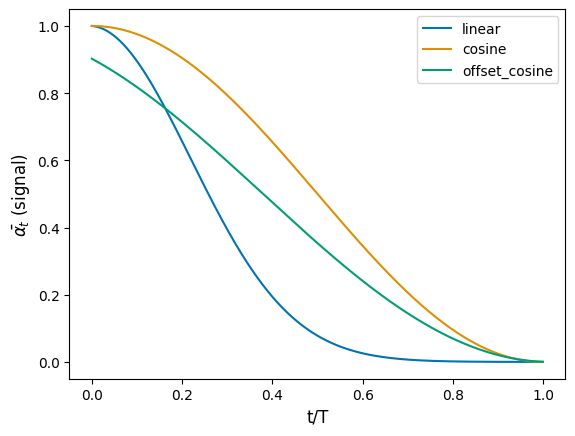

In [13]:
# 디퓨전 스케줄에서 신호 비율의 제곱을 플롯
plt.plot(
    diffusion_times, linear_signal_rates**2, linewidth=1.5, label="linear"  # 선형 스케줄
)
plt.plot(
    diffusion_times, cosine_signal_rates**2, linewidth=1.5, label="cosine"  # 코사인 스케줄
)
plt.plot(
    diffusion_times,
    offset_cosine_signal_rates**2,
    linewidth=1.5,
    label="offset_cosine",  # 오프셋 코사인 스케줄
)

# x축 및 y축 라벨 설정
plt.xlabel("t/T", fontsize=12)  # 디퓨전 시간 (0~1)
plt.ylabel(r"$\bar{\alpha_t}$ (signal)", fontsize=12)  # 누적 신호 비율

# 범례 추가
plt.legend()

# 플롯 표시
plt.show()


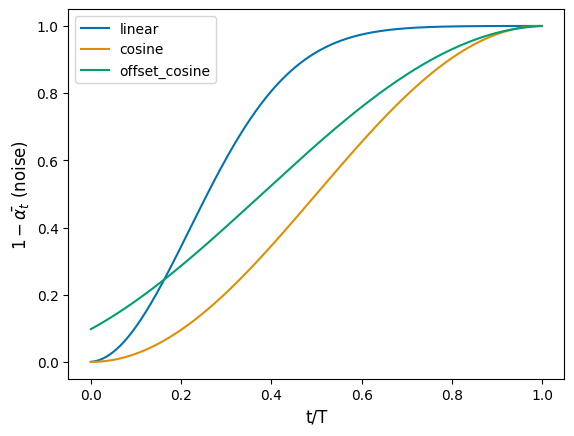

In [14]:
# 디퓨전 스케줄에서 노이즈 비율의 제곱을 플롯
plt.plot(
    diffusion_times, linear_noise_rates**2, linewidth=1.5, label="linear"  # 선형 스케줄
)
plt.plot(
    diffusion_times, cosine_noise_rates**2, linewidth=1.5, label="cosine"  # 코사인 스케줄
)
plt.plot(
    diffusion_times,
    offset_cosine_noise_rates**2,
    linewidth=1.5,
    label="offset_cosine",  # 오프셋 코사인 스케줄
)

# x축 및 y축 라벨 설정
plt.xlabel("t/T", fontsize=12)  # 디퓨전 시간 (0~1)
plt.ylabel(r"$1-\bar{\alpha_t}$ (noise)", fontsize=12)  # 누적 노이즈 비율

# 범례 추가
plt.legend()

# 플롯 표시
plt.show()


## 3. 모델 구축
-----

In [15]:
from tensorflow.keras.saving import register_keras_serializable

@register_keras_serializable()  # Keras에서 사용자 정의 함수로 등록
def sinusoidal_embedding(x):
    frequencies = tf.exp(
        tf.linspace(
            tf.math.log(1.0),
            tf.math.log(1000.0),
            NOISE_EMBEDDING_SIZE // 2,
        )
    )
    angular_speeds = 2.0 * math.pi * frequencies
    embeddings = tf.concat(
        [tf.sin(angular_speeds * x), tf.cos(angular_speeds * x)], axis=3
    )
    return embeddings

    # 각속도 계산
    # 주파수에 2π를 곱해 각속도를 생성
    angular_speeds = 2.0 * math.pi * frequencies

    # 사인 및 코사인 임베딩 계산
    # 입력 텐서(x)에 각속도를 곱한 값을 사용
    embeddings = tf.concat(
        [tf.sin(angular_speeds * x),      # 사인 임베딩
         tf.cos(angular_speeds * x)],     # 코사인 임베딩
        axis=3                            # 마지막 축을 기준으로 결합
    )

    # 임베딩 반환
    return embeddings


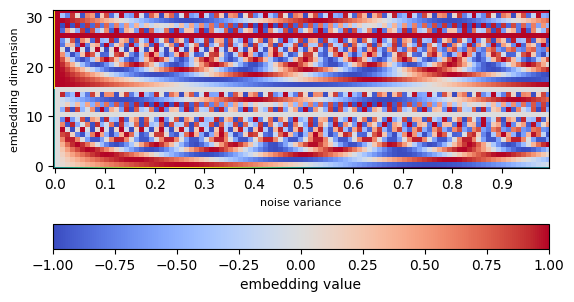

In [16]:
# 임베딩 값을 시각화하기 위한 리스트 생성
embedding_list = []
for y in np.arange(0, 1, 0.01):  # 0부터 1까지 0.01 간격으로 반복
    # 임베딩 계산 후 리스트에 추가
    embedding_list.append(sinusoidal_embedding(np.array([[[[y]]]]))[0][0][0])

# 임베딩 리스트를 배열로 변환하고 전치하여 준비
embedding_array = np.array(np.transpose(embedding_list))

# 그래프 생성 및 시각화
fig, ax = plt.subplots()  # 서브플롯 생성

# x축 눈금 설정 (0부터 1까지 0.1 간격으로 표시)
ax.set_xticks(
    np.arange(0, 100, 10), labels=np.round(np.arange(0.0, 1.0, 0.1), 1)
)
# y축 레이블 설정 (임베딩 차원)
ax.set_ylabel("embedding dimension", fontsize=8)

# x축 레이블 설정 (노이즈 분산)
ax.set_xlabel("noise variance", fontsize=8)

# 컬러 맵을 사용한 시각화
plt.pcolor(embedding_array, cmap="coolwarm")  # coolwarm 컬러맵 사용
plt.colorbar(orientation="horizontal", label="embedding value")  # 컬러바 추가

# 임베딩 배열을 이미지 형태로 표시
ax.imshow(embedding_array, interpolation="nearest", origin="lower")

# 그래프 출력
plt.show()


In [17]:
# 잔차 블록(Residual Block)을 정의
def ResidualBlock(width):
    def apply(x):
        # 입력 텐서의 채널 수를 확인
        input_width = x.shape[3]

        # 입력의 채널 수가 목표 채널 수와 같은 경우 그대로 사용, 다를 경우 1x1 컨볼루션 적용
        if input_width == width:
            residual = x  # 잔차 연결 그대로 유지
        else:
            residual = layers.Conv2D(width, kernel_size=1)(x)  # 채널 수 조정

        # 배치 정규화를 통해 학습 안정성 증가
        x = layers.BatchNormalization(center=False, scale=False)(x)

        # 첫 번째 컨볼루션 레이어 (Swish 활성화 함수 사용)
        x = layers.Conv2D(
            width, kernel_size=3, padding="same", activation=activations.swish
        )(x)

        # 두 번째 컨볼루션 레이어 (활성화 함수 없음)
        x = layers.Conv2D(width, kernel_size=3, padding="same")(x)

        # 입력 텐서와 현재 텐서를 더해 잔차 연결 적용
        x = layers.Add()([x, residual])

        return x

    return apply


# 다운샘플링 블록(Down Block)을 정의
def DownBlock(width, block_depth):
    def apply(x):
        # 입력 텐서와 스킵 연결 리스트를 분리
        x, skips = x

        # 블록 깊이만큼 잔차 블록 반복 적용
        for _ in range(block_depth):
            x = ResidualBlock(width)(x)  # 잔차 블록 적용
            skips.append(x)  # 스킵 연결에 현재 텐서 추가

        # 평균 풀링을 통해 다운샘플링 적용
        x = layers.AveragePooling2D(pool_size=2)(x)

        return x

    return apply


# 업샘플링 블록(Up Block)을 정의
def UpBlock(width, block_depth):
    def apply(x):
        # 입력 텐서와 스킵 연결 리스트를 분리
        x, skips = x

        # 업샘플링 적용 (bilinear 보간)
        x = layers.UpSampling2D(size=2, interpolation="bilinear")(x)

        # 블록 깊이만큼 잔차 블록 반복 적용
        for _ in range(block_depth):
            # 스킵 연결에서 텐서를 꺼내 현재 텐서와 결합
            x = layers.Concatenate()([x, skips.pop()])
            x = ResidualBlock(width)(x)  # 잔차 블록 적용

        return x

    return apply


In [18]:
# U-Net 모델 구축

# 입력 텐서 정의
noisy_images = layers.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3))  # 노이즈가 포함된 이미지 입력
x = layers.Conv2D(32, kernel_size=1)(noisy_images)  # 채널 크기 조정을 위한 1x1 컨볼루션

# 노이즈 분산 입력 및 임베딩
noise_variances = layers.Input(shape=(1, 1, 1))  # 노이즈 분산 입력
noise_embedding = layers.Lambda(sinusoidal_embedding)(noise_variances)  # 사인 임베딩 적용
noise_embedding = layers.UpSampling2D(size=IMAGE_SIZE, interpolation="nearest")(
    noise_embedding
)  # 임베딩을 이미지 크기로 업샘플링

# 노이즈 임베딩과 입력 이미지 결합
x = layers.Concatenate()([x, noise_embedding])  # 채널 방향으로 결합

# 스킵 연결을 저장할 리스트 초기화
skips = []

# 다운샘플링 블록
x = DownBlock(32, block_depth=2)([x, skips])  # 첫 번째 다운샘플링 블록
x = DownBlock(64, block_depth=2)([x, skips])  # 두 번째 다운샘플링 블록
x = DownBlock(96, block_depth=2)([x, skips])  # 세 번째 다운샘플링 블록

# 병목(Bottleneck)
x = ResidualBlock(128)(x)  # 첫 번째 잔차 블록
x = ResidualBlock(128)(x)  # 두 번째 잔차 블록

# 업샘플링 블록
x = UpBlock(96, block_depth=2)([x, skips])  # 첫 번째 업샘플링 블록
x = UpBlock(64, block_depth=2)([x, skips])  # 두 번째 업샘플링 블록
x = UpBlock(32, block_depth=2)([x, skips])  # 세 번째 업샘플링 블록

# 출력 레이어
x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(x)  # 출력 채널 크기 3 (RGB)

# 모델 생성
unet = models.Model([noisy_images, noise_variances], x, name="unet")  # U-Net 모델 정의


In [19]:
# 디퓨전 모델 클래스 정의
class DiffusionModel(models.Model):
    def __init__(self):
        super().__init__()

        # 정규화 레이어
        self.normalizer = layers.Normalization()  # 입력 데이터를 정규화
        # U-Net 네트워크
        self.network = unet  # 이전에 정의된 U-Net을 사용
        # 지수 이동 평균 네트워크 (EMA를 사용하여 안정적인 가중치 업데이트)
        self.ema_network = models.clone_model(self.network)
        # 디퓨전 스케줄
        self.diffusion_schedule = offset_cosine_diffusion_schedule  # 디퓨전 스케줄 함수

    def compile(self, **kwargs):
        super().compile(**kwargs)
        # 잡음 손실 추적
        self.noise_loss_tracker = metrics.Mean(name="n_loss")

    @property
    def metrics(self):
        # 훈련 및 테스트 메트릭 반환
        return [self.noise_loss_tracker]

    def denormalize(self, images):
        # 정규화된 이미지를 원래 범위(0~1)로 되돌림
        images = self.normalizer.mean + images * self.normalizer.variance**0.5
        return tf.clip_by_value(images, 0.0, 1.0)

    def denoise(self, noisy_images, noise_rates, signal_rates, training):
        # 노이즈를 제거하고 이미지를 복구
        if training:
            network = self.network  # 훈련 중에는 기본 네트워크 사용
        else:
            network = self.ema_network  # 테스트 중에는 EMA 네트워크 사용
        pred_noises = network(
            [noisy_images, noise_rates**2], training=training  # 예측된 노이즈
        )
        pred_images = (noisy_images - noise_rates * pred_noises) / signal_rates
        return pred_noises, pred_images

    def reverse_diffusion(self, initial_noise, diffusion_steps):
        # 디퓨전 과정을 역으로 진행하여 이미지를 생성
        num_images = initial_noise.shape[0]
        step_size = 1.0 / diffusion_steps
        current_images = initial_noise
        for step in range(diffusion_steps):
            diffusion_times = tf.ones((num_images, 1, 1, 1)) - step * step_size
            noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
            pred_noises, pred_images = self.denoise(
                current_images, noise_rates, signal_rates, training=False
            )
            next_diffusion_times = diffusion_times - step_size
            next_noise_rates, next_signal_rates = self.diffusion_schedule(
                next_diffusion_times
            )
            current_images = (
                next_signal_rates * pred_images + next_noise_rates * pred_noises
            )
        return pred_images

    def generate(self, num_images, diffusion_steps, initial_noise=None):
        # 주어진 노이즈로부터 이미지를 생성
        if initial_noise is None:
            initial_noise = tf.random.normal(
                shape=(num_images, IMAGE_SIZE, IMAGE_SIZE, 3)
            )
        generated_images = self.reverse_diffusion(
            initial_noise, diffusion_steps
        )
        generated_images = self.denormalize(generated_images)
        return generated_images

    def train_step(self, images):
        # 모델의 한 훈련 스텝 정의
        images = self.normalizer(images, training=True)
        noises = tf.random.normal(shape=(BATCH_SIZE, IMAGE_SIZE, IMAGE_SIZE, 3))

        diffusion_times = tf.random.uniform(
            shape=(BATCH_SIZE, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)

        noisy_images = signal_rates * images + noise_rates * noises

        with tf.GradientTape() as tape:
            # 노이즈를 예측하고 손실 계산
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, training=True
            )
            noise_loss = self.loss(noises, pred_noises)

        # 손실을 기반으로 네트워크 가중치 업데이트
        gradients = tape.gradient(noise_loss, self.network.trainable_weights)
        self.optimizer.apply_gradients(
            zip(gradients, self.network.trainable_weights)
        )

        # 손실 업데이트
        self.noise_loss_tracker.update_state(noise_loss)

        # EMA 업데이트
        for weight, ema_weight in zip(
            self.network.weights, self.ema_network.weights
        ):
            ema_weight.assign(EMA * ema_weight + (1 - EMA) * weight)

        return {m.name: m.result() for m in self.metrics}

    def test_step(self, images):
        # 모델의 한 테스트 스텝 정의
        images = self.normalizer(images, training=False)
        noises = tf.random.normal(shape=(BATCH_SIZE, IMAGE_SIZE, IMAGE_SIZE, 3))
        diffusion_times = tf.random.uniform(
            shape=(BATCH_SIZE, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        noisy_images = signal_rates * images + noise_rates * noises
        pred_noises, pred_images = self.denoise(
            noisy_images, noise_rates, signal_rates, training=False
        )
        noise_loss = self.loss(noises, pred_noises)
        self.noise_loss_tracker.update_state(noise_loss)

        return {m.name: m.result() for m in self.metrics}


In [20]:
# DiffusionModel 클래스의 인스턴스를 생성
ddm = DiffusionModel()  # 디퓨전 모델 객체 생성

# Normalization 레이어를 데이터에 적응시킴
# train 데이터셋의 통계를 기반으로 정규화(mean, variance) 파라미터를 설정
ddm.normalizer.adapt(train)


In [21]:
# 모델 로드 여부 확인
if LOAD_MODEL:  # LOAD_MODEL이 True로 설정된 경우
    ddm.built = True  # 모델이 이미 빌드되었음을 명시
    ddm.load_weights("./checkpoint/checkpoint.ckpt")  # 저장된 가중치를 지정된 경로에서 로드


# 4. 모델 훈련
-----

In [24]:
from tensorflow.keras.optimizers import AdamW  # AdamW 옵티마이저를 임포트

# DiffusionModel을 컴파일합니다.
ddm.compile(
    # 옵티마이저 설정
    optimizer=AdamW(
        learning_rate=LEARNING_RATE,  # 학습률 설정 (모델 가중치 업데이트 속도)
        weight_decay=WEIGHT_DECAY     # 가중치 감쇠 설정 (L2 정규화로 과적합 방지)
    ),
    # 손실 함수 설정
    loss=losses.MeanAbsoluteError(),  # 평균 절대 오차(MAE)를 클래스 기반으로 사용
)



Epoch 1/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - n_loss: 0.3021
Saved to ./output/generated_img_000.png


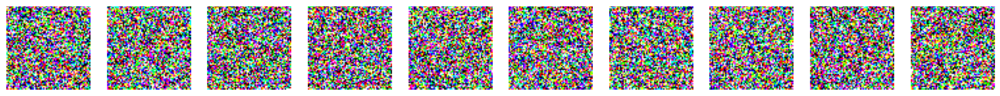

639/639 ━━━━━━━━━━━━━━━━━━━━ 93s 95ms/step - n_loss: 0.3020
Epoch 2/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1969
Saved to ./output/generated_img_001.png


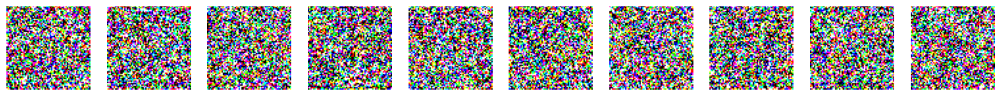

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 93ms/step - n_loss: 0.1969
Epoch 3/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - n_loss: 0.1916
Saved to ./output/generated_img_002.png


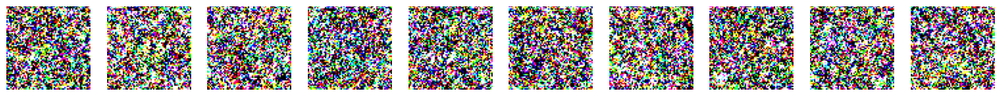

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 93ms/step - n_loss: 0.1916
Epoch 4/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1868
Saved to ./output/generated_img_003.png


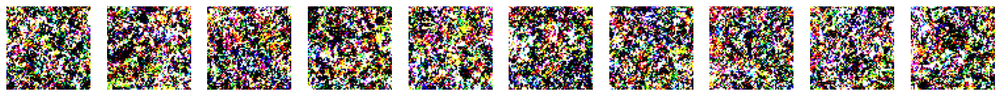

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1868
Epoch 5/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1839
Saved to ./output/generated_img_004.png


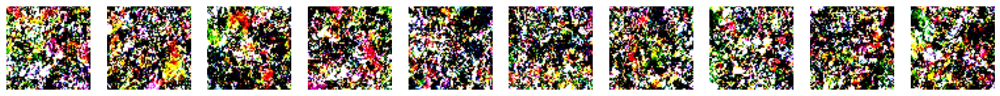

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 93ms/step - n_loss: 0.1839
Epoch 6/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1825
Saved to ./output/generated_img_005.png


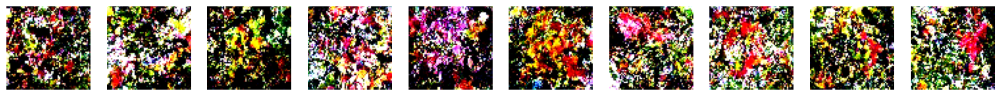

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 93ms/step - n_loss: 0.1825
Epoch 7/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1814
Saved to ./output/generated_img_006.png


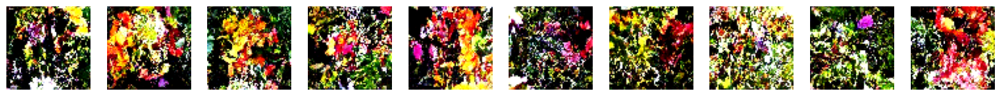

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1814
Epoch 8/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - n_loss: 0.1795
Saved to ./output/generated_img_007.png


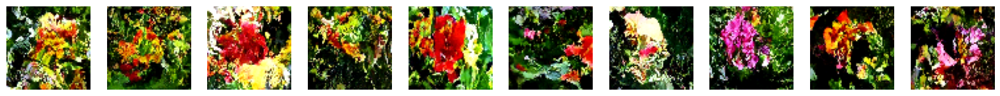

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1795
Epoch 9/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - n_loss: 0.1786
Saved to ./output/generated_img_008.png


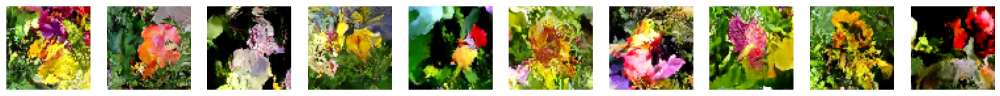

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1786
Epoch 10/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1783
Saved to ./output/generated_img_009.png


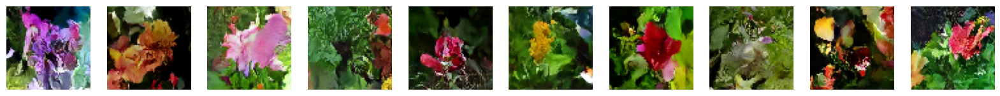

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1783
Epoch 11/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1775
Saved to ./output/generated_img_010.png


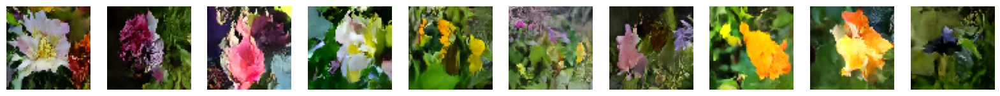

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1775
Epoch 12/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - n_loss: 0.1772
Saved to ./output/generated_img_011.png


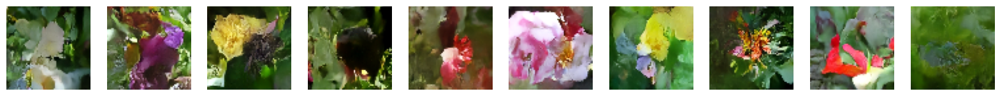

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 95ms/step - n_loss: 0.1772
Epoch 13/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1770
Saved to ./output/generated_img_012.png


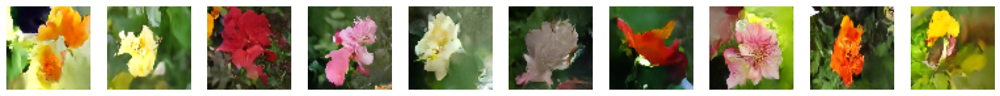

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 93ms/step - n_loss: 0.1770
Epoch 14/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1763
Saved to ./output/generated_img_013.png


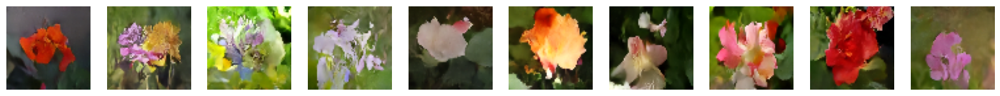

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1763
Epoch 15/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1761
Saved to ./output/generated_img_014.png


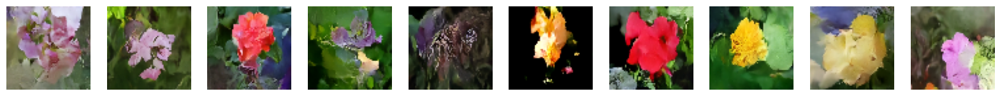

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1761
Epoch 16/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1762
Saved to ./output/generated_img_015.png


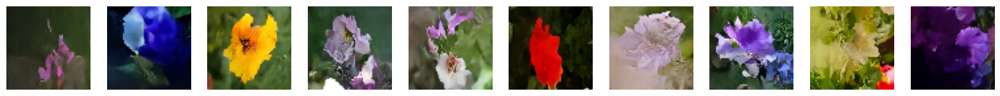

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 93ms/step - n_loss: 0.1762
Epoch 17/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1751
Saved to ./output/generated_img_016.png


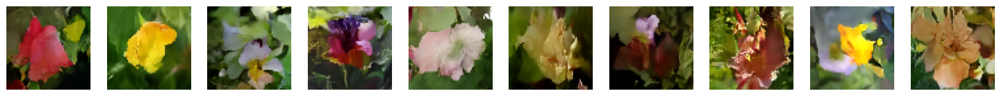

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1751
Epoch 18/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1751
Saved to ./output/generated_img_017.png


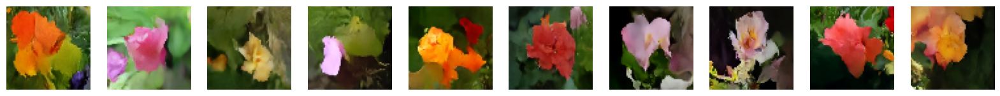

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1751
Epoch 19/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1743
Saved to ./output/generated_img_018.png


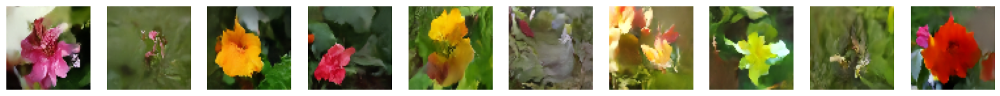

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 93ms/step - n_loss: 0.1743
Epoch 20/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1741
Saved to ./output/generated_img_019.png


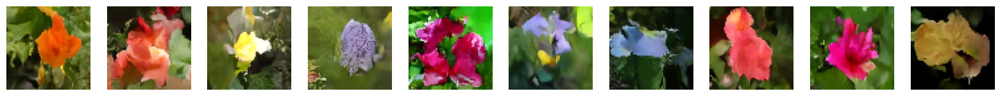

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1741
Epoch 21/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1743
Saved to ./output/generated_img_020.png


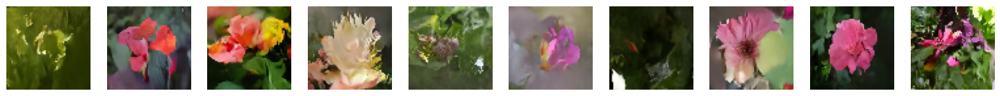

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1743
Epoch 22/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1748
Saved to ./output/generated_img_021.png


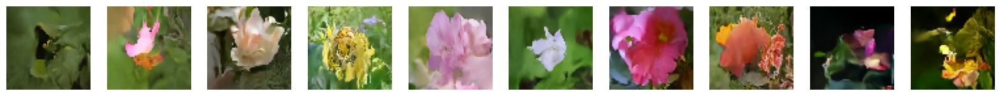

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1748
Epoch 23/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1736
Saved to ./output/generated_img_022.png


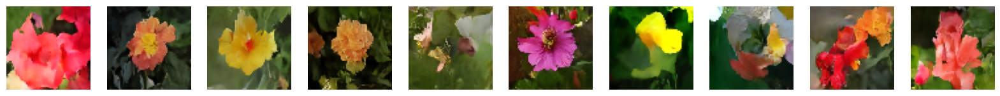

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 93ms/step - n_loss: 0.1736
Epoch 24/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1733
Saved to ./output/generated_img_023.png


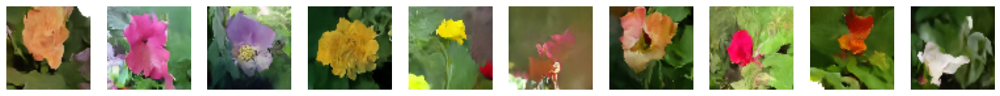

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1733
Epoch 25/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1732
Saved to ./output/generated_img_024.png


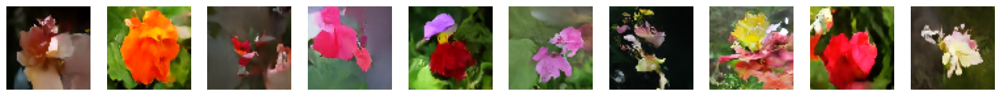

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 93ms/step - n_loss: 0.1732
Epoch 26/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1737
Saved to ./output/generated_img_025.png


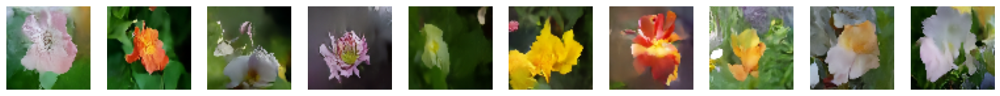

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 93ms/step - n_loss: 0.1737
Epoch 27/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1737
Saved to ./output/generated_img_026.png


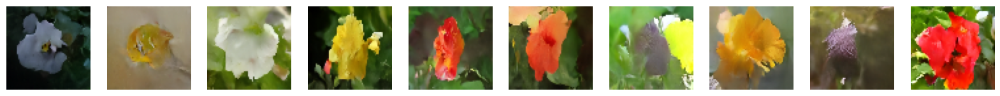

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1737
Epoch 28/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1732
Saved to ./output/generated_img_027.png


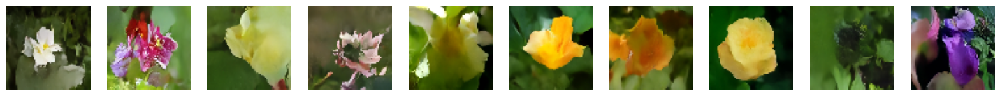

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1732
Epoch 29/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1748
Saved to ./output/generated_img_028.png


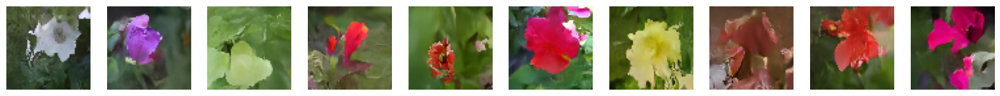

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1748
Epoch 30/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1742
Saved to ./output/generated_img_029.png


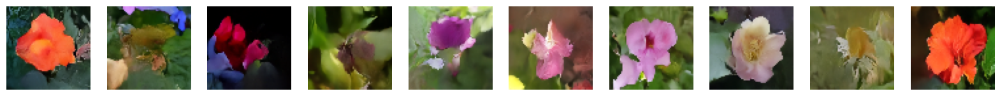

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1742
Epoch 31/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1729
Saved to ./output/generated_img_030.png


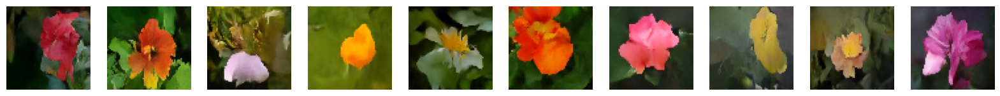

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1729
Epoch 32/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1726
Saved to ./output/generated_img_031.png


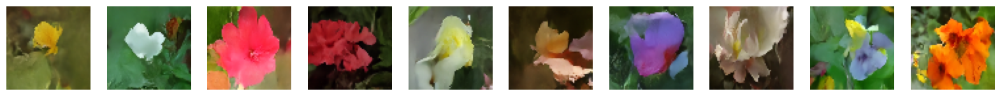

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 93ms/step - n_loss: 0.1726
Epoch 33/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1715
Saved to ./output/generated_img_032.png


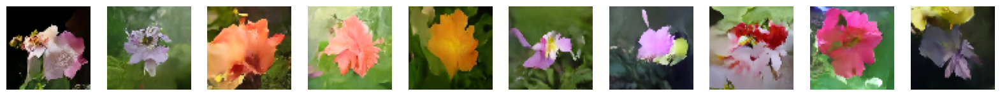

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1715
Epoch 34/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1726
Saved to ./output/generated_img_033.png


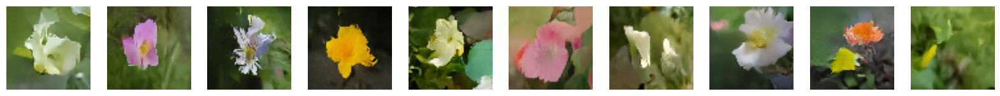

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1726
Epoch 35/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1727
Saved to ./output/generated_img_034.png


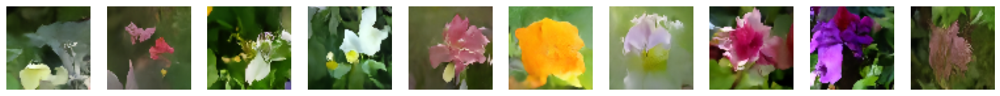

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1727
Epoch 36/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1728
Saved to ./output/generated_img_035.png


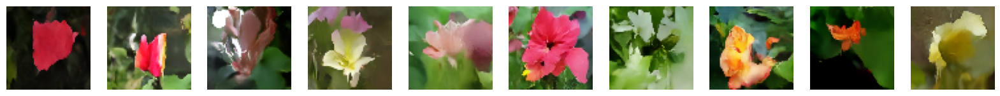

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 93ms/step - n_loss: 0.1728
Epoch 37/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1718
Saved to ./output/generated_img_036.png


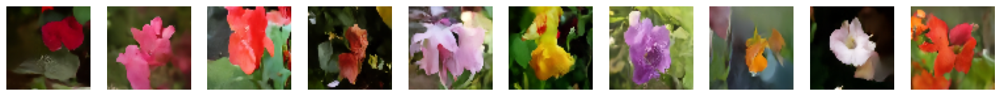

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1718
Epoch 38/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1728
Saved to ./output/generated_img_037.png


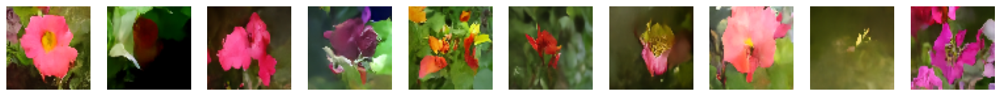

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1728
Epoch 39/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1718
Saved to ./output/generated_img_038.png


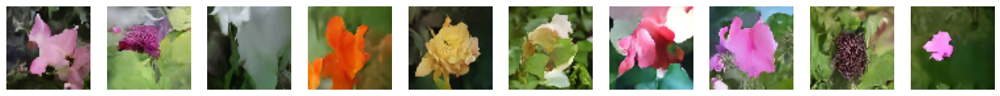

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1718
Epoch 40/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1720
Saved to ./output/generated_img_039.png


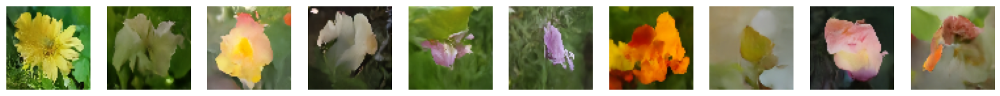

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1720
Epoch 41/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1721
Saved to ./output/generated_img_040.png


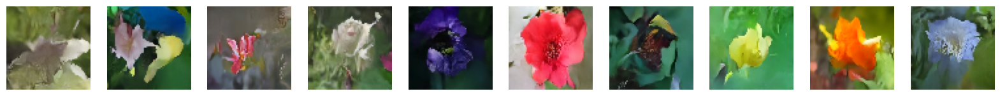

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1721
Epoch 42/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1729
Saved to ./output/generated_img_041.png


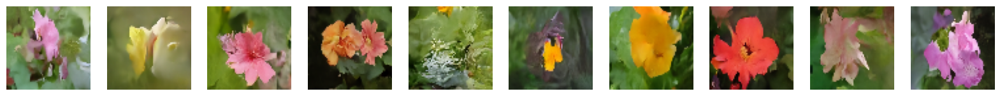

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1729
Epoch 43/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1721
Saved to ./output/generated_img_042.png


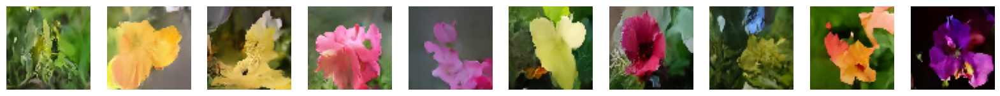

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1721
Epoch 44/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1711
Saved to ./output/generated_img_043.png


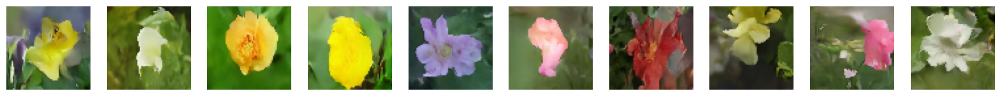

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1711
Epoch 45/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1710
Saved to ./output/generated_img_044.png


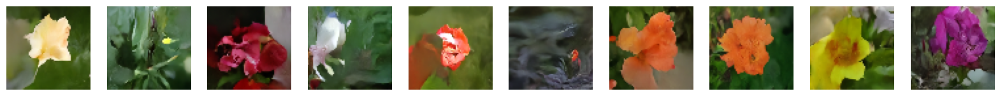

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 93ms/step - n_loss: 0.1710
Epoch 46/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1725
Saved to ./output/generated_img_045.png


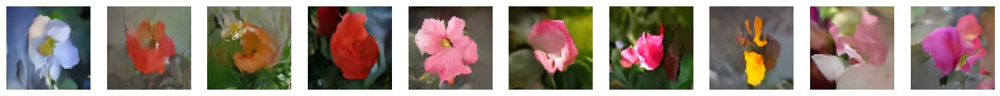

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1725
Epoch 47/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1717
Saved to ./output/generated_img_046.png


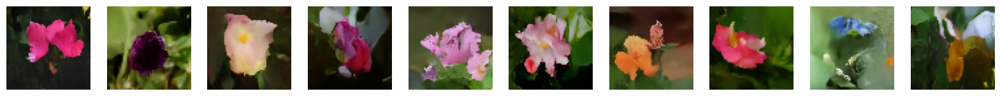

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1717
Epoch 48/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - n_loss: 0.1719
Saved to ./output/generated_img_047.png


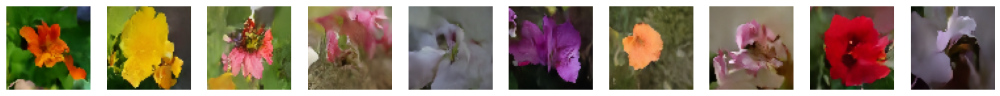

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1719
Epoch 49/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1707
Saved to ./output/generated_img_048.png


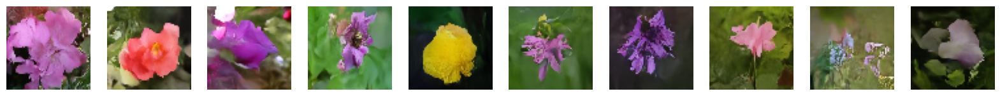

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1707
Epoch 50/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - n_loss: 0.1717
Saved to ./output/generated_img_049.png


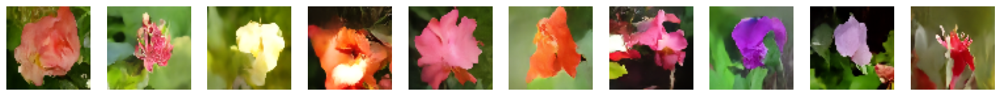

639/639 ━━━━━━━━━━━━━━━━━━━━ 60s 94ms/step - n_loss: 0.1717


In [26]:
# 훈련을 실행하고, 생성된 이미지를 주기적으로 출력하기 위한 콜백 설정

# 모델 가중치를 주기적으로 저장하는 체크포인트 콜백
# 모델 가중치를 주기적으로 저장하는 체크포인트 콜백
model_checkpoint_callback = callbacks.ModelCheckpoint(
    filepath="./checkpoint/checkpoint.weights.h5",  # 파일 경로를 .weights.h5로 변경
    save_weights_only=True,  # 모델 구조는 저장하지 않고 가중치만 저장
    save_freq="epoch",  # 매 에포크마다 저장
    verbose=0,  # 출력 메시지 생략
)


# TensorBoard 로그를 기록하는 콜백
tensorboard_callback = callbacks.TensorBoard(
    log_dir="./logs"  # 로그 파일 저장 경로
)

# 에포크 종료 시 이미지를 생성하고 저장하는 사용자 정의 콜백
class ImageGenerator(callbacks.Callback):
    def __init__(self, num_img):
        self.num_img = num_img  # 생성할 이미지 수 설정

    def on_epoch_end(self, epoch, logs=None):
        # 모델을 사용하여 이미지를 생성
        generated_images = self.model.generate(
            num_images=self.num_img,  # 생성할 이미지 수
            diffusion_steps=PLOT_DIFFUSION_STEPS,  # 디퓨전 스텝 수
        ).numpy()

        # 생성된 이미지를 출력 및 저장
        display(
            generated_images,
            save_to="./output/generated_img_%03d.png" % (epoch),  # 저장 파일명 설정
        )

# 생성할 이미지 개수를 10으로 설정하여 ImageGenerator 콜백 생성
image_generator_callback = ImageGenerator(num_img=10)

# 모델 훈련 실행
ddm.fit(
    train,  # 훈련 데이터
    epochs=EPOCHS,  # 총 에포크 수
    callbacks=[  # 훈련 중 사용할 콜백 리스트
        model_checkpoint_callback,  # 가중치 저장 콜백
        tensorboard_callback,  # TensorBoard 로깅 콜백
        image_generator_callback,  # 이미지 생성 및 저장 콜백
    ],
)


## 5. 추론
-----

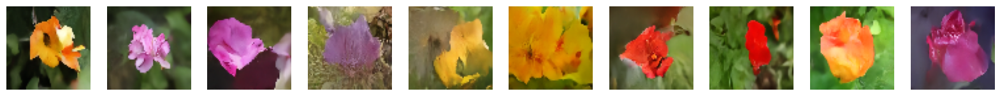

In [27]:
# 새로운 꽃 이미지 생성
# DiffusionModel 객체(ddm)를 사용하여 새로운 이미지를 생성합니다.
generated_images = ddm.generate(
    num_images=10,      # 생성할 이미지 개수 (10장)
    diffusion_steps=20  # 디퓨전 스텝 수 (20단계로 생성)
).numpy()  # 결과를 NumPy 배열로 변환

# 생성된 이미지를 화면에 출력
display(generated_images)  # display 함수는 이미지를 시각화하거나 저장합니다.


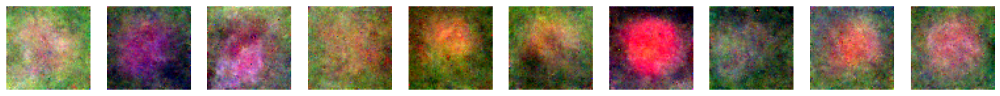

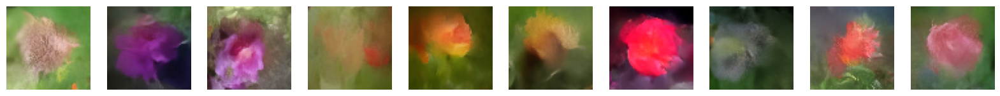

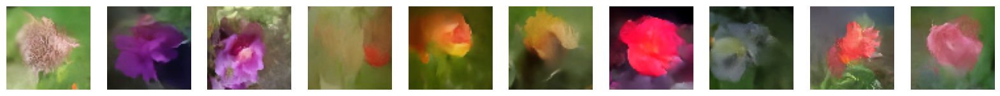

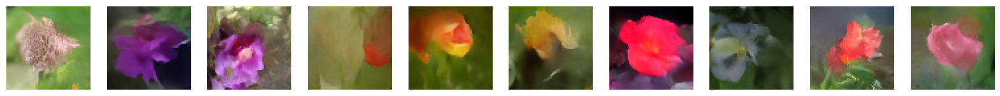

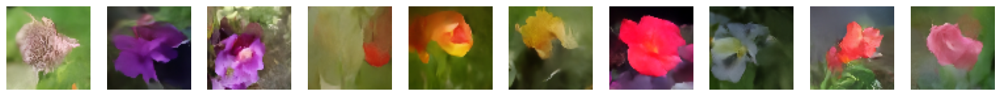

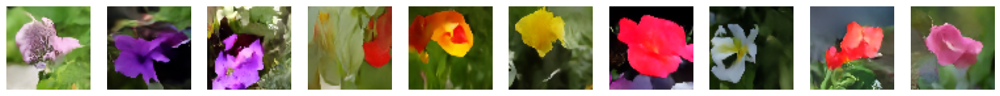

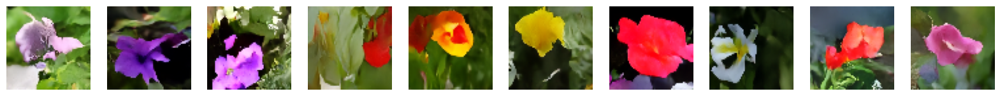

In [28]:
# 확산 단계(diffusion_steps) 증가에 따른 이미지 품질 향상을 확인
for diffusion_steps in list(np.arange(1, 6, 1)) + [20] + [100]:  # 확산 단계 설정
    # 확산 단계:
    # 1~5, 20, 100 단계로 설정하여 이미지 품질 비교

    tf.random.set_seed(42)  # 랜덤 시드 고정 (결과 재현성을 위해)

    # 이미지 생성
    generated_images = ddm.generate(
        num_images=10,         # 생성할 이미지 수 (10장)
        diffusion_steps=diffusion_steps,  # 현재 반복에서 설정된 확산 단계
    ).numpy()  # 결과를 NumPy 배열로 변환

    # 생성된 이미지를 시각화
    display(generated_images)  # 이미지 출력 (또는 저장)


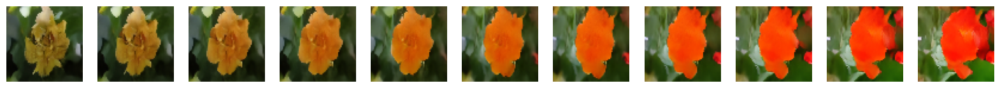

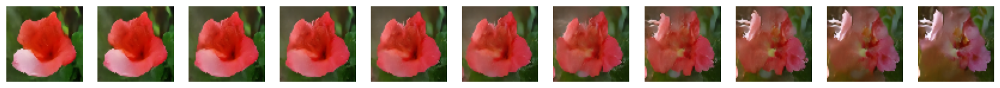

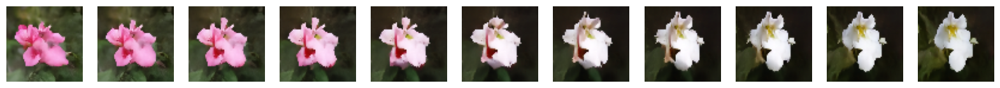

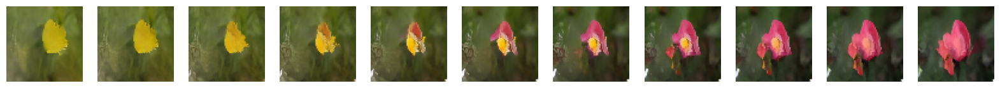

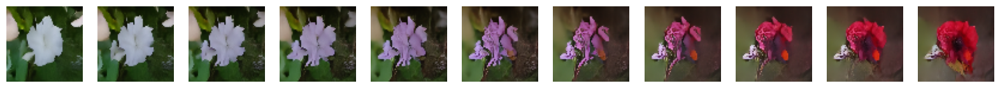

In [30]:
# 잡음 공간에서 두 포인트 사이를 보간하여 이미지를 생성
tf.random.set_seed(100)  # 랜덤 시드 설정

# 구면 보간 함수 정의
def spherical_interpolation(a, b, t):
    # 두 벡터 a와 b 사이의 구면 보간
    return np.sin(t * math.pi / 2) * a + np.cos(t * math.pi / 2) * b

# 반복적으로 보간된 잡음을 사용하여 이미지 생성
for i in range(5):
    # 두 개의 랜덤 잡음 벡터 생성
    a = tf.random.normal(shape=(IMAGE_SIZE, IMAGE_SIZE, 3))  # 첫 번째 랜덤 벡터
    b = tf.random.normal(shape=(IMAGE_SIZE, IMAGE_SIZE, 3))  # 두 번째 랜덤 벡터

    # 보간된 잡음 생성 (11개의 보간 단계)
    interpolated_noises = [
        spherical_interpolation(a, b, t) for t in np.arange(0, 1.1, 0.1)
    ]

    # 보간된 잡음의 크기를 (num_images, IMAGE_SIZE, IMAGE_SIZE, 3)로 설정
    initial_noise = tf.stack(interpolated_noises, axis=0)  # 리스트를 텐서로 변환

    # 보간된 잡음을 사용하여 이미지 생성
    generated_images = ddm.generate(
        num_images=initial_noise.shape[0],  # 생성할 이미지 수 = 보간 단계 수
        diffusion_steps=20,                # 디퓨전 스텝 수
        initial_noise=initial_noise        # 초기 잡음 설정
    ).numpy()  # 결과를 NumPy 배열로 변환

    # 생성된 이미지를 출력
    display(generated_images, n=11)  # 보간된 이미지 11장을 출력

